<a href="https://colab.research.google.com/github/Risuo/Springboard/blob/master/v_0_1_RGB_Working_prototype.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [40]:
!pip install tifffile

In [0]:
!pip install -q pyyaml h5py  # Required to save models in HDF5 format

In [0]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import pandas as pd
from shapely.wkt import loads as wkt_loads
import tifffile as tiff
import os
import random
from keras.models import Model
from keras.layers import Input, merge, Convolution2D, MaxPooling2D, UpSampling2D, Reshape, core, Dropout
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint, LearningRateScheduler
from keras import backend as K
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.metrics import jaccard_similarity_score
from shapely.geometry import MultiPolygon, Polygon
import shapely.wkt
import shapely.affinity
from collections import defaultdict
import pickle

In [43]:
keras.__version__

'2.2.4-tf'

In [44]:
keras.backend.image_data_format()

'channels_first'

In [0]:
keras.backend.set_image_data_format('channels_first')

In [46]:
keras.backend.image_data_format()

'channels_first'

In [47]:
keras.backend.backend()

'tensorflow'

In [48]:
__author__ = "n01z3"


N_Cls = 10
inDir = '/content/drive/My Drive/Capstone/Kaggle/Kaggle Data'
DF = pd.read_csv(inDir + '/train_wkt_v4.csv')
GS = pd.read_csv(inDir + '/grid_sizes.csv', names=['ImageId', 'Xmax', 'Ymin'], skiprows=1)
SB = pd.read_csv(os.path.join(inDir, 'sample_submission.csv'))
ISZ = 160
smooth = 1e-10 # orig = 1e-12

def _convert_coordinates_to_raster(coords, img_size, xymax):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    Xmax, Ymax = xymax
    H, W = img_size
    W1 = 1.0 * W * W / (W + 1)
    H1 = 1.0 * H * H / (H + 1)
    xf = W1 / Xmax
    yf = H1 / Ymax
    coords[:, 1] *= yf
    coords[:, 0] *= xf
    coords_int = np.round(coords).astype(np.int32)
    return coords_int


def _get_xmax_ymin(grid_sizes_panda, imageId):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    xmax, ymin = grid_sizes_panda[grid_sizes_panda.ImageId == imageId].iloc[0, 1:].astype(float)
    return (xmax, ymin)


def _get_polygon_list(wkt_list_pandas, imageId, cType):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    df_image = wkt_list_pandas[wkt_list_pandas.ImageId == imageId]
    multipoly_def = df_image[df_image.ClassType == cType].MultipolygonWKT
    polygonList = None
    if len(multipoly_def) > 0:
        assert len(multipoly_def) == 1
        polygonList = wkt_loads(multipoly_def.values[0])
    return polygonList


def _get_and_convert_contours(polygonList, raster_img_size, xymax):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    perim_list = []
    interior_list = []
    if polygonList is None:
        return None
    for k in range(len(polygonList)):
        poly = polygonList[k]
        perim = np.array(list(poly.exterior.coords))
        perim_c = _convert_coordinates_to_raster(perim, raster_img_size, xymax)
        perim_list.append(perim_c)
        for pi in poly.interiors:
            interior = np.array(list(pi.coords))
            interior_c = _convert_coordinates_to_raster(interior, raster_img_size, xymax)
            interior_list.append(interior_c)
    return perim_list, interior_list


def _plot_mask_from_contours(raster_img_size, contours, class_value=1):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    img_mask = np.zeros(raster_img_size, np.uint8)
    if contours is None:
        return img_mask
    perim_list, interior_list = contours
    cv2.fillPoly(img_mask, perim_list, class_value)
    cv2.fillPoly(img_mask, interior_list, 0)
    return img_mask


def generate_mask_for_image_and_class(raster_size, imageId, class_type, grid_sizes_panda=GS, wkt_list_pandas=DF):
    # __author__ = visoft
    # https://www.kaggle.com/visoft/dstl-satellite-imagery-feature-detection/export-pixel-wise-mask
    xymax = _get_xmax_ymin(grid_sizes_panda, imageId)
    polygon_list = _get_polygon_list(wkt_list_pandas, imageId, class_type)
    contours = _get_and_convert_contours(polygon_list, raster_size, xymax)
    mask = _plot_mask_from_contours(raster_size, contours, 1)
    return mask


def M(image_id):
    # __author__ = amaia
    # https://www.kaggle.com/aamaia/dstl-satellite-imagery-feature-detection/rgb-using-m-bands-example
    filename = os.path.join(inDir, 'sixteen_band', '{}_M.tif'.format(image_id))
    img = tiff.imread(filename)
    img = np.rollaxis(img, 0, 3)
    return img

def RGB(image_id):
  filename = os.path.join(inDir, 'three_band', '{}.tif'.format(image_id))
  img = tiff.imread(filename)
  img = np.rollaxis(img, 0, 3)
  return img


def stretch_n(bands, lower_percent=5, higher_percent=95):
    out = np.zeros_like(bands).astype(np.float32)
    n = bands.shape[2]
    for i in range(n):
        a = 0  # np.min(band)
        b = 1  # np.max(band)
        c = np.percentile(bands[:, :, i], lower_percent)
        d = np.percentile(bands[:, :, i], higher_percent)
        t = a + (bands[:, :, i] - c) * (b - a) / (d - c)
        t[t < a] = a
        t[t > b] = b
        out[:, :, i] = t

    return out.astype(np.float32)

def jaccard_coef(y_true, y_pred):
    # __author__ = Vladimir Iglovikov
    intersection = K.sum(y_true * y_pred, axis=[0, -1, -2])
    sum_ = K.sum(y_true + y_pred, axis=[0, -1, -2])

    jac = (intersection + smooth) / (sum_ - intersection + smooth)

    return K.mean(jac)


def jaccard_coef_int(y_true, y_pred):
    # __author__ = Vladimir Iglovikov
    y_pred_pos = K.round(K.clip(y_pred, 0, 1))

    intersection = K.sum(y_true * y_pred_pos, axis=[0, -1, -2])
    sum_ = K.sum(y_true + y_pred_pos, axis=[0, -1, -2])
    jac = (intersection + smooth) / (sum_ - intersection + smooth)
    return K.mean(jac)


def stick_all_train():
    print("let's stick all imgs together")
    s = 835

    x = np.zeros((5 * s, 5 * s, 3))
    y = np.zeros((5 * s, 5 * s, N_Cls))

    ids = sorted(DF.ImageId.unique())
    print(len(ids))
    for i in range(5):
        for j in range(5):
            id = ids[5 * i + j]

            img = RGB(id)
            img = stretch_n(img)
            tiff.imshow(x); 
            x[s * i:s * i + s, s * j:s * j + s, :] = img[:s, :s, :]
            for z in range(N_Cls):
                y[s * i:s * i + s, s * j:s * j + s, z] = generate_mask_for_image_and_class(
                    (img.shape[0], img.shape[1]), id, z + 1)[:s, :s]
                    
    np.save('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_trn_rgb_%d' % N_Cls, x)
    np.save('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_trn_rgb_%d' % N_Cls, y)


def get_patches(img, msk, amt=10000, aug=True):
    is2 = int(1.0 * ISZ)
    xm, ym = img.shape[0] - is2, img.shape[1] - is2

    x, y = [], []

    tr = [0.4, 0.1, 0.1, 0.15, 0.3, 0.95, 0.1, 0.05, 0.001, 0.005]
    for i in range(amt):
        xc = random.randint(0, xm)
        yc = random.randint(0, ym)

        im = img[xc:xc + is2, yc:yc + is2]
        #if i % 250 == 0:
        #  tiff.imshow(im);
        ms = msk[xc:xc + is2, yc:yc + is2]
        #if i % 250 == 0:
        #  tiff.imshow(ms);

        for j in range(N_Cls):
            sm = np.sum(ms[:, :, j])
            if 1.0 * sm / is2 ** 2 > tr[j]:
                if aug:
                    if random.uniform(0, 1) > 0.5:
                        im = im[::-1]
                        ms = ms[::-1]
                    if random.uniform(0, 1) > 0.5:
                        im = im[:, ::-1]
                        ms = ms[:, ::-1]

                x.append(im)
                y.append(ms)

    x, y = 2 * np.transpose(x, (0, 3, 1, 2)) - 1, np.transpose(y, (0, 3, 1, 2))
    print(x.shape, y.shape)
    return x, y


def make_val():
    print("let's pick some samples for validation")
    img = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_trn_rgb_%d.npy' % N_Cls)
    msk = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_trn_rgb_%d.npy' % N_Cls)
    x, y = get_patches(img, msk, amt=4000)

    np.save('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_tmp_rgb_%d' % N_Cls, x)
    np.save('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_tmp_rgb_%d' % N_Cls, y)


#def get_unet():



def calc_jacc_out(model):
    img = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_tmp_rgb_%d.npy' % N_Cls)
    msk = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_tmp_rgb_%d.npy' % N_Cls)

    prd = model.predict(img, batch_size=4)
    avg, trs = [], []

    for i in range(N_Cls):
        t_msk = msk[:, i, :, :]
        t_prd = prd[:, i, :, :]
        t_msk = t_msk.reshape(msk.shape[0] * msk.shape[2], msk.shape[3])
        t_prd = t_prd.reshape(msk.shape[0] * msk.shape[2], msk.shape[3])

        m, b_tr = 0, 0
        for j in range(10):
            tr = j / 10.0
            pred_binary_mask = t_prd > tr

            jk = jaccard_similarity_score(t_msk, pred_binary_mask)
            if jk > m:
                m = jk
                b_tr = tr
        print(i, m, b_tr)
        avg.append(m)
        trs.append(b_tr)

    score = sum(avg) / 10.0
    return score, trs

def calc_jacc_in(model, x_val, y_val):
    img = x_val #np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_tmp_%d.npy' % N_Cls)
    msk = y_val #np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_tmp_%d.npy' % N_Cls)

    prd = model.predict(img, batch_size=4)
    print(prd.shape, msk.shape)
    avg, trs = [], []

    for i in range(N_Cls):
        t_msk = msk[:, i, :, :]
        t_prd = prd[:, i, :, :]
        t_msk = t_msk.reshape(msk.shape[0] * msk.shape[2], msk.shape[3])
        t_prd = t_prd.reshape(msk.shape[0] * msk.shape[2], msk.shape[3])

        m, b_tr = 0, 0
        for j in range(10):
            tr = j / 10.0
            pred_binary_mask = t_prd > tr

            jk = jaccard_similarity_score(t_msk, pred_binary_mask)
            if jk > m:
                m = jk
                b_tr = tr
        print(i, m, b_tr)
        avg.append(m)
        trs.append(b_tr)

    score = sum(avg) / 10.0
    return score, trs


def mask_for_polygons(polygons, im_size):
    # __author__ = Konstantin Lopuhin
    # https://www.kaggle.com/lopuhin/dstl-satellite-imagery-feature-detection/full-pipeline-demo-poly-pixels-ml-poly
    img_mask = np.zeros(im_size, np.uint8)
    if not polygons:
        return img_mask
    int_coords = lambda x: np.array(x).round().astype(np.int32)
    exteriors = [int_coords(poly.exterior.coords) for poly in polygons]
    interiors = [int_coords(pi.coords) for poly in polygons
                 for pi in poly.interiors]
    cv2.fillPoly(img_mask, exteriors, 1)
    cv2.fillPoly(img_mask, interiors, 0)
    return img_mask


def mask_to_polygons(mask, epsilon=5, min_area=1.):
    # __author__ = Konstantin Lopuhin
    # https://www.kaggle.com/lopuhin/dstl-satellite-imagery-feature-detection/full-pipeline-demo-poly-pixels-ml-poly

    # first, find contours with cv2: it's much faster than shapely
    contours, hierarchy = cv2.findContours(
        ((mask == 1) * 255).astype(np.uint8),
        cv2.RETR_CCOMP, cv2.CHAIN_APPROX_TC89_KCOS)
    # create approximate contours to have reasonable submission size
    approx_contours = [cv2.approxPolyDP(cnt, epsilon, True)
                       for cnt in contours]
    if not contours:
        return MultiPolygon()
    # now messy stuff to associate parent and child contours
    cnt_children = defaultdict(list)
    child_contours = set()
    assert hierarchy.shape[0] == 1
    # http://docs.opencv.org/3.1.0/d9/d8b/tutorial_py_contours_hierarchy.html
    for idx, (_, _, _, parent_idx) in enumerate(hierarchy[0]):
        if parent_idx != -1:
            child_contours.add(idx)
            cnt_children[parent_idx].append(approx_contours[idx])
    # create actual polygons filtering by area (removes artifacts)
    all_polygons = []
    for idx, cnt in enumerate(approx_contours):
        if idx not in child_contours and cv2.contourArea(cnt) >= min_area:
            assert cnt.shape[1] == 1
            poly = Polygon(
                shell=cnt[:, 0, :],
                holes=[c[:, 0, :] for c in cnt_children.get(idx, [])
                       if cv2.contourArea(c) >= min_area])
            all_polygons.append(poly)
    # approximating polygons might have created invalid ones, fix them
    all_polygons = MultiPolygon(all_polygons)
    if not all_polygons.is_valid:
        all_polygons = all_polygons.buffer(0)
        # Sometimes buffer() converts a simple Multipolygon to just a Polygon,
        # need to keep it a Multi throughout
        if all_polygons.type == 'Polygon':
            all_polygons = MultiPolygon([all_polygons])
    return all_polygons


def get_scalers(im_size, x_max, y_min):
    # __author__ = Konstantin Lopuhin
    # https://www.kaggle.com/lopuhin/dstl-satellite-imagery-feature-detection/full-pipeline-demo-poly-pixels-ml-poly
    h, w = im_size  # they are flipped so that mask_for_polygons works correctly
    h, w = float(h), float(w)
    w_ = 1.0 * w * (w / (w + 1))
    h_ = 1.0 * h * (h / (h + 1))
    return w_ / x_max, h_ / y_min


def train_net(multi_iter, batch_size, epochs, test = False): # 10 multi_iter, 64 batch size, 30 epochs
    multi_iter = multi_iter
    batch_size = batch_size
    epochs = epochs

    print("start train net")

    x_val = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_tmp_rgb_%d.npy' % N_Cls) 
    print('x_val loaded')
    y_val = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_tmp_rgb_%d.npy' % N_Cls)
    print('y_val loaded')
    img = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_trn_rgb_%d.npy' % N_Cls)
    print('img loaded')
    msk = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_trn_rgb_%d.npy' % N_Cls)
    print('msk loaded')
    print(x_val.shape, y_val.shape, img.shape, msk.shape)
    
    if not test:
        amt = 10000

    
    if test:
      print('running test variant')
      x_val = x_val[:200]
      y_val = y_val[:200]
      amt = 150
      print(x_val.shape, y_val.shape, img.shape, msk.shape)
    x_trn, y_trn = get_patches(img, msk, amt)

    print(x_trn.shape, y_trn.shape, 'shapes of x_trn & y_trn here')

    model = get_unet()
    #model.load_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/trained_weights_unet_10_jk0.8845')
    model_checkpoint = ModelCheckpoint('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/unet_tmp_rgb.hdf5', monitor='loss', save_best_only=True)
    for i in range(multi_iter):
        history = model.fit(x_trn, y_trn, batch_size=batch_size, epochs=epochs, verbose=1, shuffle=True,
                  callbacks=[model_checkpoint], validation_data=(x_val, y_val))

        del x_trn
        del y_trn
        x_trn, y_trn = get_patches(img, msk, amt)
        score, trs = calc_jacc_in(model, x_val, y_val)
        
        print('val jk', score)
        
        with open('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/History/trainHistoryDictRGB%.4f' % score, 'wb') as file_pi:
          pickle.dump(history.history, file_pi)
        
        model.save_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/trained_weights_unet_10_RGB_jk%.4f' % score)
    
    return model, history

"""
def train_net(multi_iter, batch_size, epochs, test=False): # 10 multi_iter, 64 batch size, 30 epochs
    multi_iter = multi_iter
    batch_size = batch_size
    epochs = epochs

    print("start train net")
    x_val = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_tmp_rgb_%d.npy' % N_Cls) 
    y_val = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_tmp_rgb_%d.npy' % N_Cls)
    img = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/x_trn_rgb_%d.npy' % N_Cls)
    msk = np.load('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/data/y_trn_rgb_%d.npy' % N_Cls)

    x_trn, y_trn = get_patches(img, msk)

    print(x_trn.shape, y_trn.shape, 'shapes of x_trn & y_trn here')

    model = get_unet()
    model.load_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/trained_weights_unet_10_jk0.8845')
    model_checkpoint = ModelCheckpoint('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/unet_tmp_rgb.hdf5', monitor='loss', save_best_only=True)
    for i in range(multi_iter):
        history = model.fit(x_trn, y_trn, batch_size=batch_size, epochs=epochs, verbose=1, shuffle=True,
                  callbacks=[model_checkpoint], validation_data=(x_val, y_val))

        del x_trn
        del y_trn
        x_trn, y_trn = get_patches(img, msk)
        score, trs = calc_jacc_in(model, x_val, y_val)
        
        print('val jk', score)
        
        with open('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/History/trainHistoryDictRGB%.4f' % score, 'wb') as file_pi:
          pickle.dump(history.history, file_pi)
        
        model.save_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/trained_weights_unet_10_RGB_jk%.4f' % score)
    
    return model, history
"""

def predict_id(id, model, trs):
    img = RGB(id)
    x = stretch_n(img)

    cnv = np.zeros((960, 960, 3)).astype(np.float32)
    prd = np.zeros((N_Cls, 960, 960)).astype(np.float32)
    cnv[:img.shape[0], :img.shape[1], :] = x

    for i in range(0, 6):
        line = []
        for j in range(0, 6):
            line.append(cnv[i * ISZ:(i + 1) * ISZ, j * ISZ:(j + 1) * ISZ])

        x = 2 * np.transpose(line, (0, 3, 1, 2)) - 1
        tmp = model.predict(x, batch_size=4)
        for j in range(tmp.shape[0]):
            prd[:, i * ISZ:(i + 1) * ISZ, j * ISZ:(j + 1) * ISZ] = tmp[j]

    # trs = [0.4, 0.1, 0.4, 0.3, 0.3, 0.5, 0.3, 0.6, 0.1, 0.1]
    for i in range(N_Cls):
        prd[i] = prd[i] > trs[i]

    return prd[:, :img.shape[0], :img.shape[1]]


def predict_test(model, trs):
    print("predict test")
    for i, id in enumerate(sorted(set(SB['ImageId'].tolist()))):
        msk = predict_id(id, model, trs)
        np.save('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/msk/10_rgb_%s' % id, msk)
        if i % 100 == 0: print(i, id)


#def make_submit():
#    print("make submission file"
#    df = pd.read_csv(os.path.join(inDir, 'sample_submission.csv'))
#    print df.head()
#    for idx, row in df.iterrows():
#        id = row[0]
#        kls = row[1] - 1
#
#        msk = np.load('msk/10_%s.npy' % id)[kls]
#        pred_polygons = mask_to_polygons(msk)
#        x_max = GS.loc[GS['ImageId'] == id, 'Xmax'].as_matrix()[0]
#        y_min = GS.loc[GS['ImageId'] == id, 'Ymin'].as_matrix()[0]
#
#        x_scaler, y_scaler = get_scalers(msk.shape, x_max, y_min)
#
#        scaled_pred_polygons = shapely.affinity.scale(pred_polygons, xfact=1.0 / x_scaler, yfact=1.0 / y_scaler,
#                                                      origin=(0, 0, 0))
#
#        df.iloc[idx, 2] = shapely.wkt.dumps(scaled_pred_polygons)
#        if idx % 100 == 0: print idx
#    print df.head()
#    df.to_csv('subm/1.csv', index=False)

"""
def check_predict(id='6120_2_3'):
    #model = get_unet()
    #model.load_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/--------')

    msk = predict_id(id, model, [0.4, 0.1, 0.4, 0.3, 0.3, 0.5, 0.3, 0.6, 0.1, 0.1])
    img = M(id)

    plt.figure()
    ax1 = plt.subplot(131)
    ax1.set_title('image ID:6120_2_3')
    ax1.imshow(img[:, :, 5], cmap=plt.get_cmap('gist_ncar'))
    ax2 = plt.subplot(132)
    ax2.set_title('predict bldg pixels')
    ax2.imshow(msk[0], cmap=plt.get_cmap('gray'))
    ax3 = plt.subplot(133)
    ax3.set_title('predict bldg polygones')
    ax3.imshow(mask_for_polygons(mask_to_polygons(msk[0], epsilon=1), img.shape[:2]), cmap=plt.get_cmap('gray'))

    plt.show()



    #make_submit()

    # bonus
"""

"\ndef check_predict(id='6120_2_3'):\n    #model = get_unet()\n    #model.load_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/--------')\n\n    msk = predict_id(id, model, [0.4, 0.1, 0.4, 0.3, 0.3, 0.5, 0.3, 0.6, 0.1, 0.1])\n    img = M(id)\n\n    plt.figure()\n    ax1 = plt.subplot(131)\n    ax1.set_title('image ID:6120_2_3')\n    ax1.imshow(img[:, :, 5], cmap=plt.get_cmap('gist_ncar'))\n    ax2 = plt.subplot(132)\n    ax2.set_title('predict bldg pixels')\n    ax2.imshow(msk[0], cmap=plt.get_cmap('gray'))\n    ax3 = plt.subplot(133)\n    ax3.set_title('predict bldg polygones')\n    ax3.imshow(mask_for_polygons(mask_to_polygons(msk[0], epsilon=1), img.shape[:2]), cmap=plt.get_cmap('gray'))\n\n    plt.show()\n\n\n\n    #make_submit()\n\n    # bonus\n"

In [0]:
keras.backend.clear_session()

In [0]:
def get_unet():
  input_size = (3, ISZ, ISZ)
  inputs = keras.Input(input_size)

  print(inputs.shape)
  conv1 = layers.Conv2D(32, (3, 3), padding = 'same', activation = 'relu')(inputs)
  print('conv1a', conv1.shape)
  conv1 = layers.Conv2D(32, (3, 3), padding = 'same', activation = 'relu')(conv1)
  print('conv1b', conv1.shape)
  pool1 = layers.MaxPool2D(pool_size = (2, 2))(conv1)
  print('pool1', pool1.shape)

  conv2 = layers.Conv2D(64, (3, 3), padding = 'same', activation = 'relu')(pool1)
  print('conv2a', conv2.shape)
  conv2 = layers.Conv2D(64, (3, 3), padding = 'same', activation = 'relu')(conv2)
  print('conv2b', conv2.shape)
  pool2 = layers.MaxPool2D(pool_size = (2, 2))(conv2)
  print('pool2', pool2.shape)

  conv3 = layers.Conv2D(128, (3, 3), padding = 'same', activation = 'relu')(pool2)
  print('conv3a', conv3.shape)
  conv3 = layers.Conv2D(128, (3, 3), padding = 'same', activation = 'relu')(conv3)
  print('conv3a', conv3.shape)
  pool3 = layers.MaxPool2D(pool_size = (2, 2))(conv3)
  print('pool3', pool3.shape)

  conv4 = layers.Conv2D(256, (3, 3), padding = 'same', activation = 'relu')(pool3)
  print('conv4a', conv4.shape)
  conv4 = layers.Conv2D(256, (3, 3), padding = 'same', activation = 'relu')(conv4)
  print('conv4b', conv4.shape)
  pool4 = layers.MaxPool2D(pool_size = (2, 2))(conv4)
  print('pool4', pool4.shape)

  conv5 = layers.Conv2D(512, (3, 3), padding ='same', activation = 'relu')(pool4)
  print('conv5a', conv5.shape)
  conv5 = layers.Conv2D(512, (3, 3), padding ='same', activation = 'relu')(conv5)
  print('conv5b', conv5.shape)

  up6 = layers.UpSampling2D(size = (2,2))(conv5)
  print('up6', up6.shape)
  concat1 = layers.Concatenate(axis = 1)([up6, conv4]) 
  print('concat1', concat1.shape)

  conv6 = layers.Conv2D(256, (3, 3), padding = 'same', activation = 'relu')(concat1)
  print('conv6a', conv6.shape)
  conv6 = layers.Conv2D(256, (3, 3), padding ='same', activation = 'relu')(conv6)
  print('conv6b', conv6.shape)

  up7 = layers.UpSampling2D(size = (2,2))(conv6)
  print('up7', up7.shape)
  concat2 = layers.Concatenate(axis = 1)([up7, conv3]) 
  print('concat2', concat2.shape)

  conv7 = layers.Conv2D(128, (3, 3), padding ='same', activation = 'relu')(concat2)
  print('conv7a', conv7.shape)
  conv7 = layers.Conv2D(128, (3, 3), padding ='same', activation = 'relu')(conv7)
  print('conv7b', conv7.shape)

  up8 = layers.UpSampling2D(size = (2,2))(conv7)
  print('up8', up8.shape)
  concat3 = layers.Concatenate(axis = 1)([up8, conv2]) 
  print('concat3', concat3.shape)


  conv8 = layers.Conv2D(64, (3, 3), padding ='same', activation = 'relu')(concat3)
  print('conv8a', conv8.shape)
  conv8 = layers.Conv2D(64, (3, 3), padding ='same', activation = 'relu')(conv8)
  print('conv8b', conv8.shape)

  up9 = layers.UpSampling2D(size = (2,2))(conv8)
  print('up9', up9.shape)
  concat4 = layers.Concatenate(axis = 1)([up9, conv1]) 
  print('concat4', concat4.shape)


  conv9 = layers.Conv2D(32, (3, 3), padding ='same', activation = 'relu')(concat4)
  print('conv9a', conv9.shape)
  conv9 = layers.Conv2D(32, (3, 3), padding ='same', activation = 'relu')(conv9)
  print('conv9b', conv9.shape)

  outputs = layers.Conv2D(N_Cls, (1, 1), activation='sigmoid')(conv9)
  print('outputs', outputs.shape)

  model = keras.Model(inputs = inputs, outputs = outputs, name = 'unet_model_rgb')
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = 1e-3, ), loss='binary_crossentropy', metrics=[jaccard_coef, jaccard_coef_int, 'accuracy'])
  return model

let's stick all imgs together
25


/usr/local/lib/python3.6/dist-packages/tifffile/tifffile.py:11738: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  facecolor='1.0', edgecolor='w')


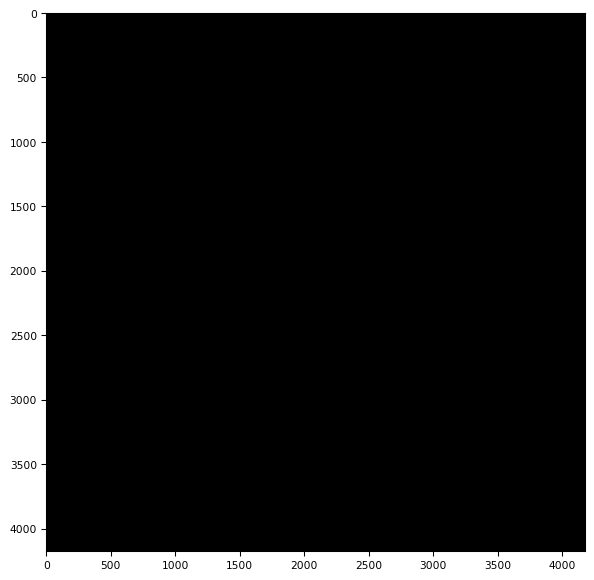

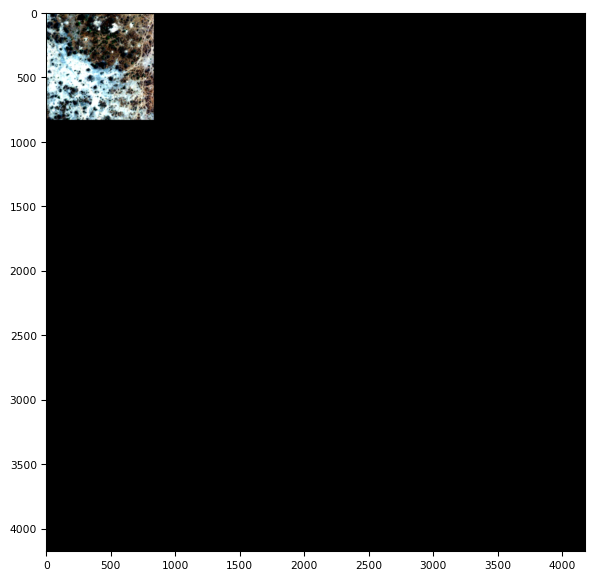

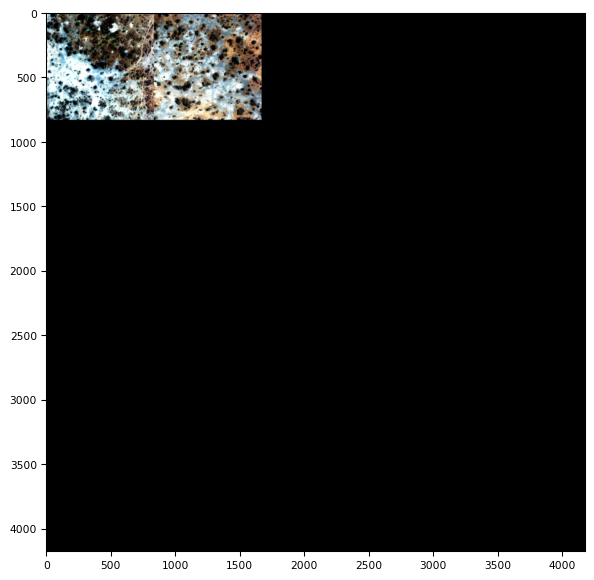

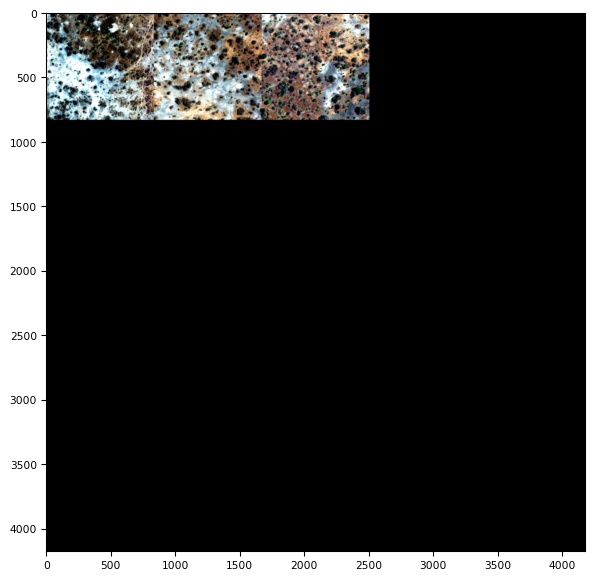

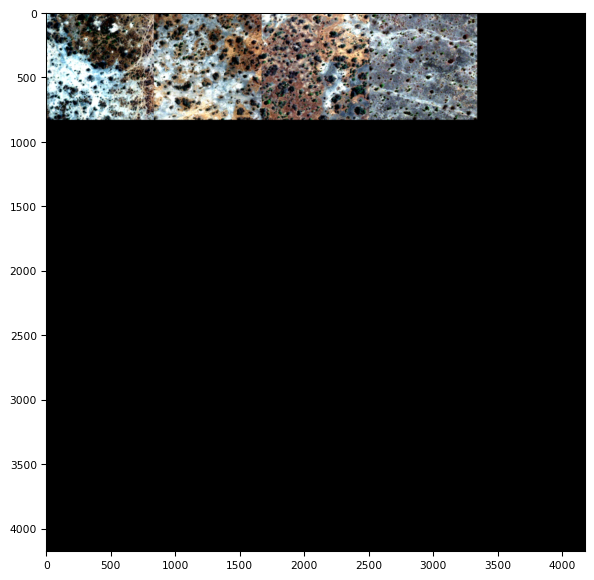

...

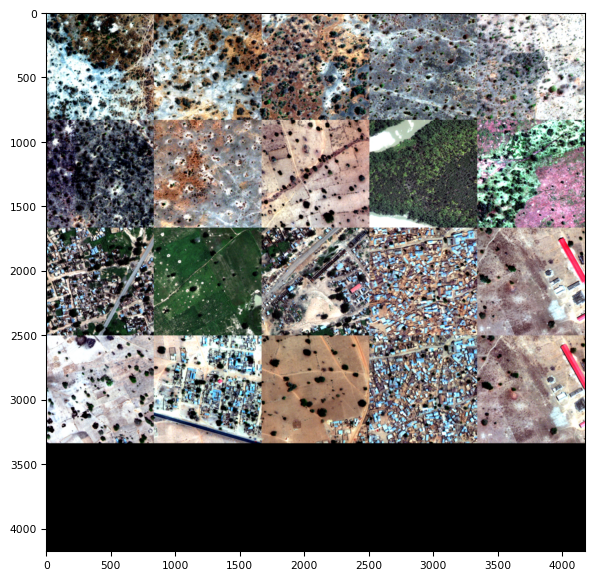

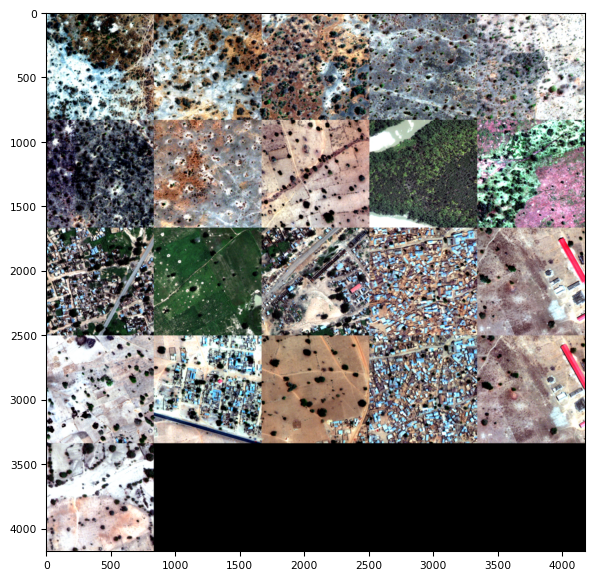

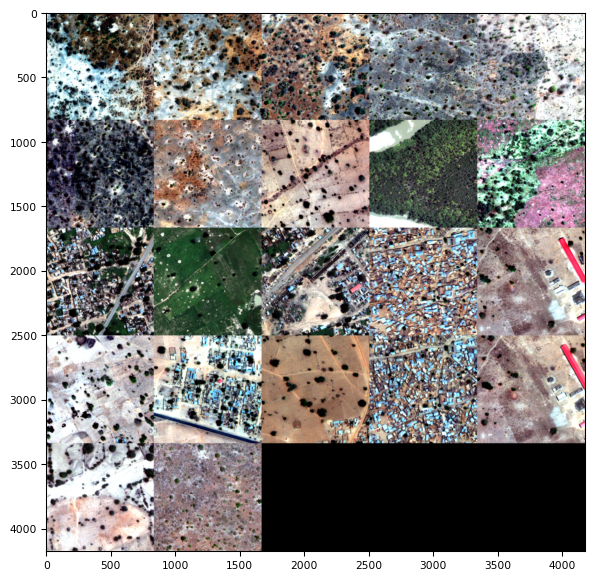

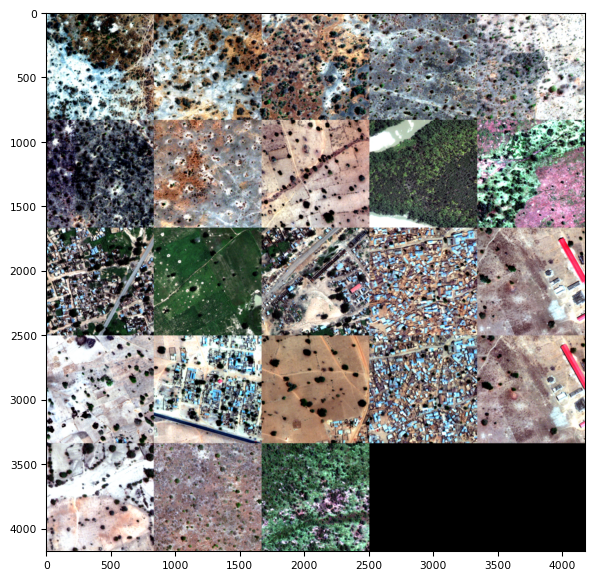

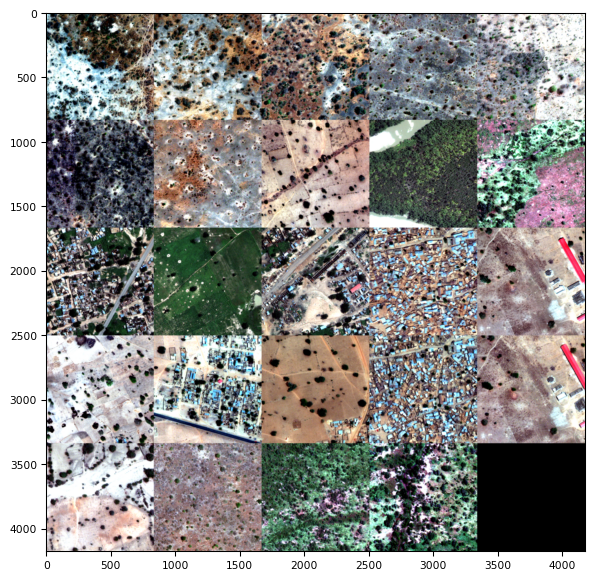

In [0]:
stick_all_train()

In [0]:
plt.close('all')

let's pick some samples for validation


/usr/local/lib/python3.6/dist-packages/tifffile/tifffile.py:11738: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  facecolor='1.0', edgecolor='w')


(1472, 3, 160, 160) (1472, 10, 160, 160)


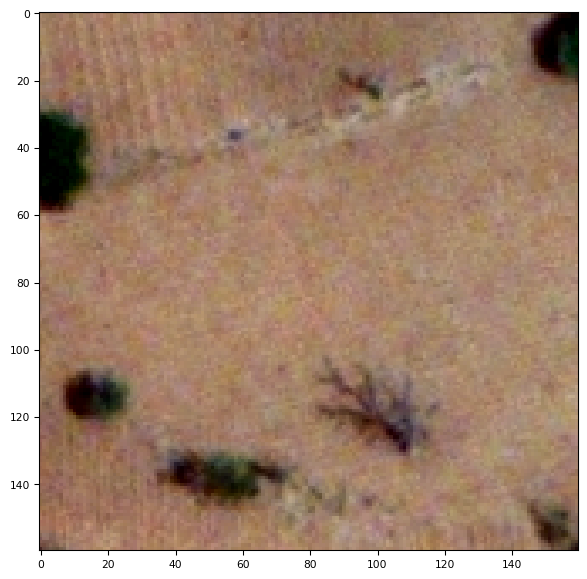

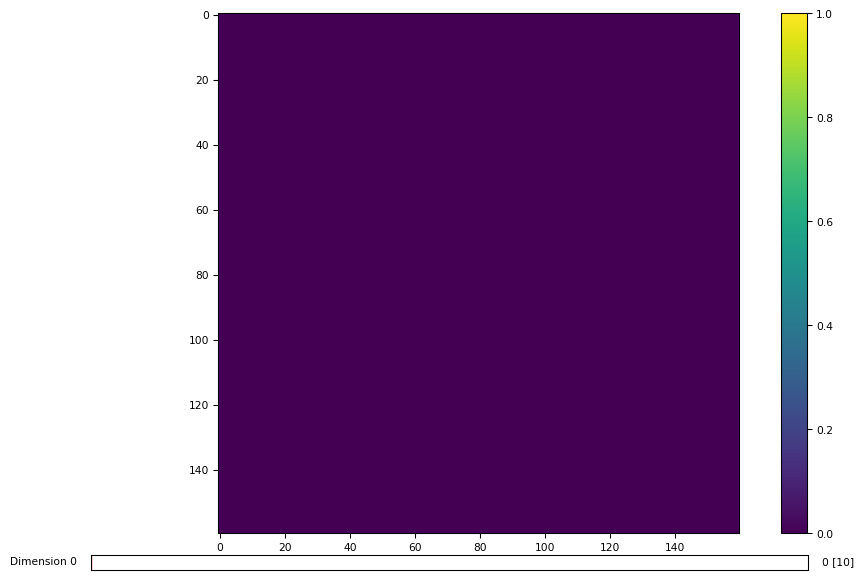

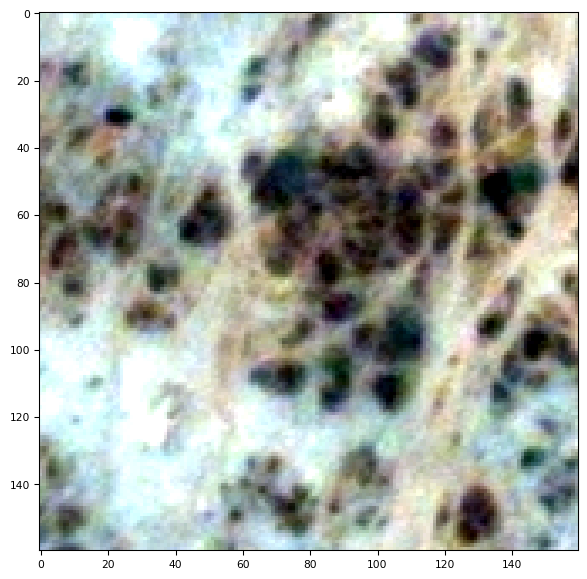

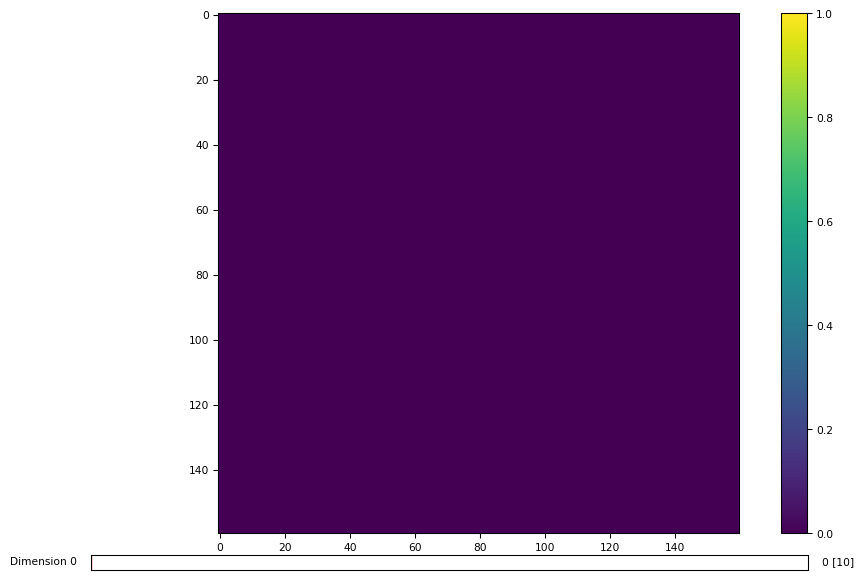

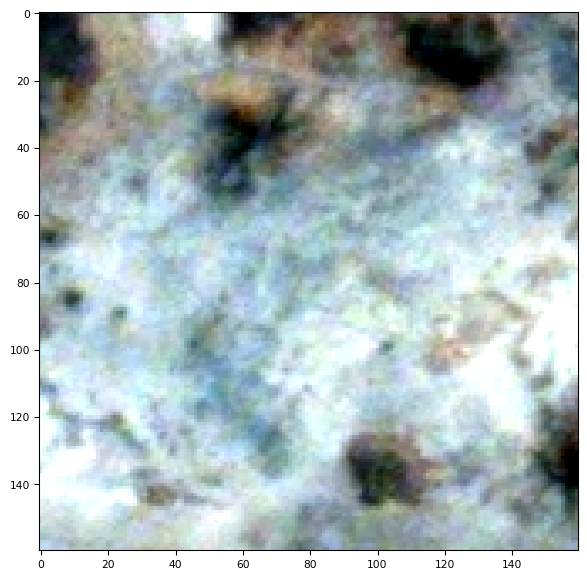

...

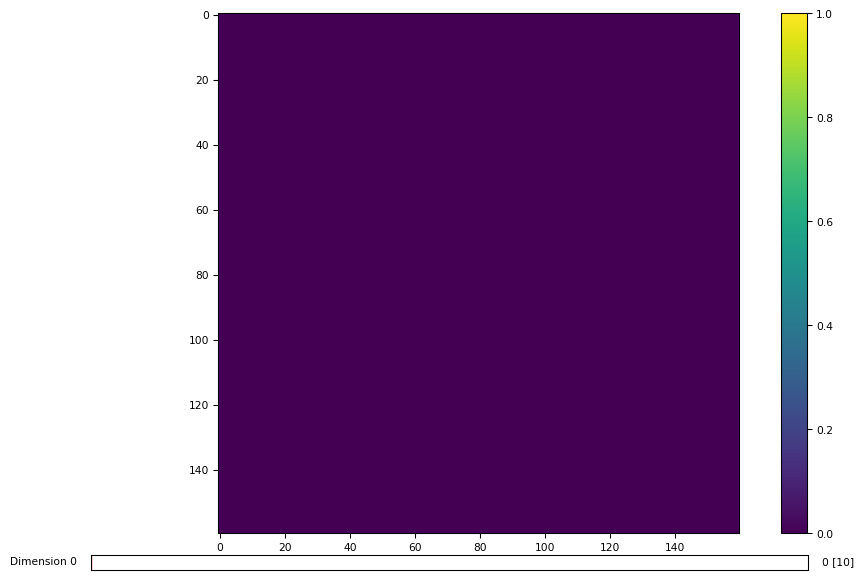

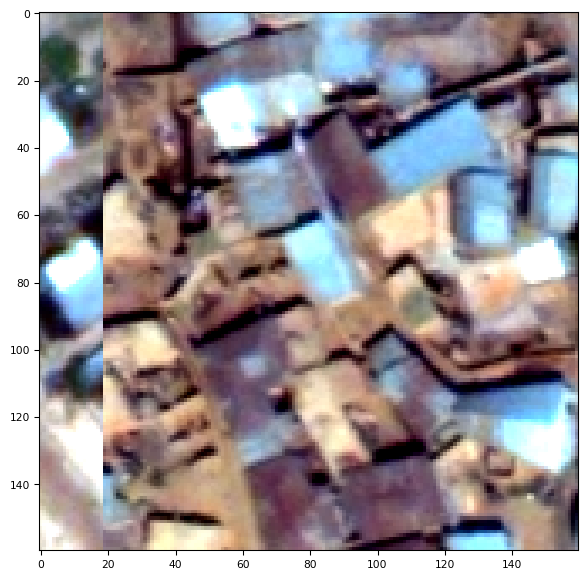

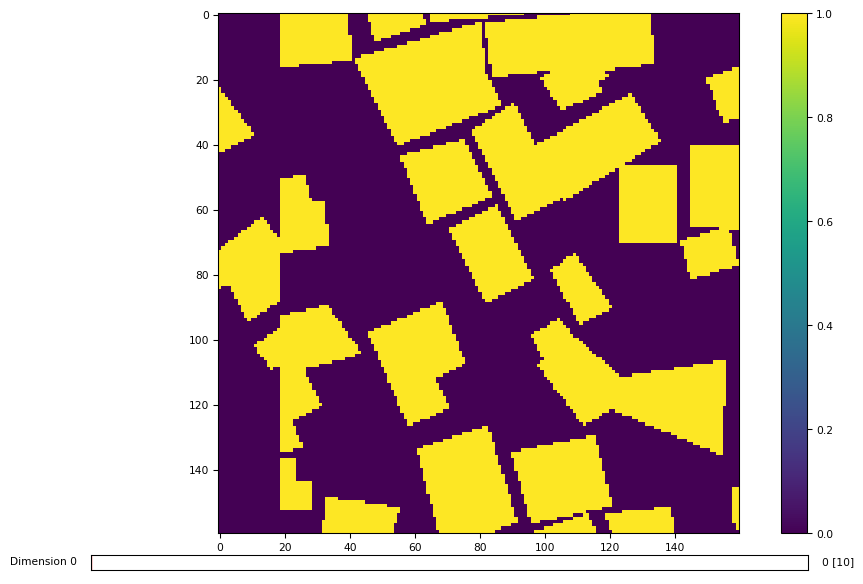

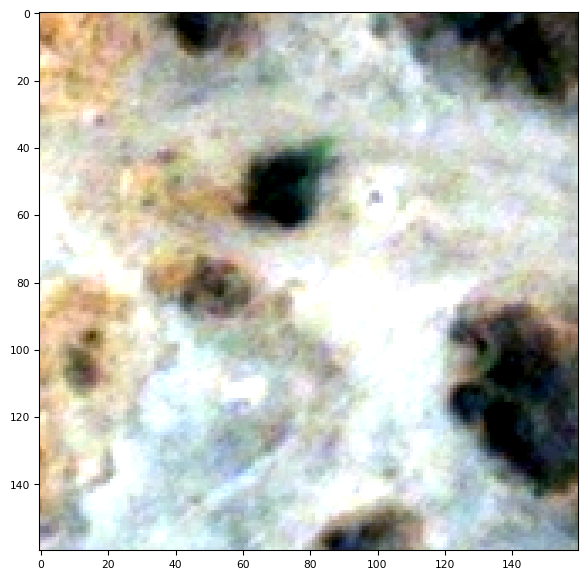

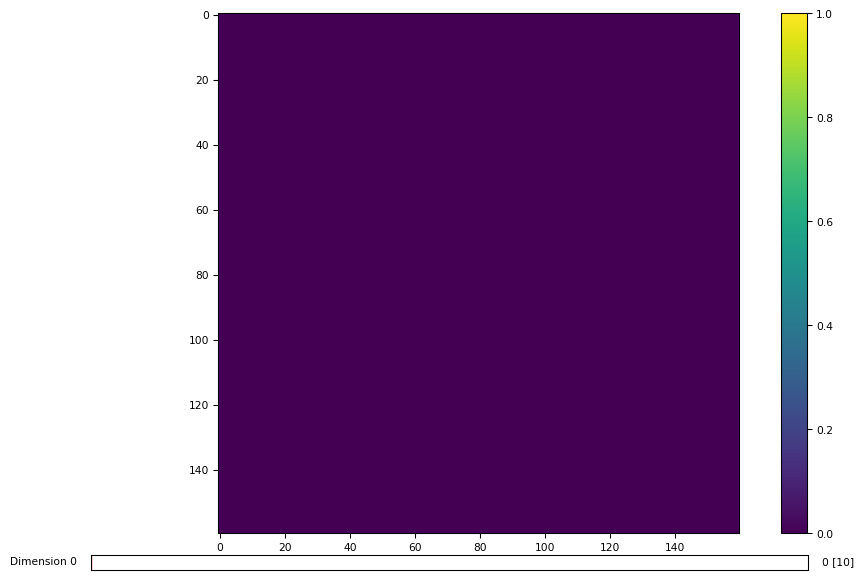

In [0]:
make_val()

In [0]:
plt.close('all')
%whos

Variable                            Type               Data/Info
----------------------------------------------------------------
Adam                                type               <class 'keras.optimizers.Adam'>
Convolution2D                       type               <class 'keras.layers.convolutional.Conv2D'>
DF                                  DataFrame                ImageId  ClassType <...>n\n[250 rows x 3 columns]
Dropout                             type               <class 'keras.layers.core.Dropout'>
GS                                  DataFrame                ImageId      Xmax  <...>n\n[450 rows x 3 columns]
ISZ                                 int                160
Input                               function           <function Input at 0x7f8837c5ea60>
K                                   module             <module 'keras.backend' f<...>ras/backend/__init__.py'>
LearningRateScheduler               type               <class 'keras.callbacks.LearningRateScheduler'>
M       

NameError: ignored

In [0]:
model, history = train_net(multi_iter = 10, batch_size = 64, epochs = 30, test = False)

#multi_iter, batch_size, epochs): # 10 multi_iter, 64 batch size, 30 epochs


start train net
x_val loaded
y_val loaded
img loaded
msk loaded
(1472, 3, 160, 160) (1472, 10, 160, 160) (4175, 4175, 3) (4175, 4175, 10)
(3613, 3, 160, 160) (3613, 10, 160, 160)
(3613, 3, 160, 160) (3613, 10, 160, 160) shapes of x_trn & y_trn here
(?, 3, 160, 160)
Instructions for updating:
If using Keras pass *_constraint arguments to layers.
conv1a (?, 32, 160, 160)
conv1b (?, 32, 160, 160)
pool1 (?, 32, 80, 80)
conv2a (?, 64, 80, 80)
conv2b (?, 64, 80, 80)
pool2 (?, 64, 40, 40)
conv3a (?, 128, 40, 40)
conv3a (?, 128, 40, 40)
pool3 (?, 128, 20, 20)
conv4a (?, 256, 20, 20)
conv4b (?, 256, 20, 20)
pool4 (?, 256, 10, 10)
conv5a (?, 512, 10, 10)
conv5b (?, 512, 10, 10)
up6 (?, 512, 20, 20)
concat1 (?, 768, 20, 20)
conv6a (?, 256, 20, 20)
conv6b (?, 256, 20, 20)
up7 (?, 256, 40, 40)
concat2 (?, 384, 40, 40)
conv7a (?, 128, 40, 40)
conv7b (?, 128, 40, 40)
up8 (?, 128, 80, 80)
concat3 (?, 192, 80, 80)
conv8a (?, 64, 80, 80)
conv8b (?, 64, 80, 80)
up9 (?, 64, 160, 160)
concat4 (?, 96, 160, 

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:664: FutureWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  FutureWarning)


0 0.8659811714999379 0.4
1 0.7347120570315804 0.3
2 0.9818968018774519 0.6
3 0.7745238287531745 0.4
4 0.7982274491618538 0.5
5 0.9665137911460798 0.7
6 0.9956795850222145 0.7
7 0.9978703989295842 0.6
8 0.9863647010449725 0.5
9 0.9482420853259105 0.4
val jk 0.905001186979276
Train on 3583 samples, validate on 1472 samples
Epoch 1/30
3583/3583 [==============================] - 31s 9ms/sample - loss: 0.0800 - jaccard_coef: 0.3254 - jaccard_coef_int: 0.3960 - acc: 0.9721 - val_loss: 0.0910 - val_jaccard_coef: 0.2066 - val_jaccard_coef_int: 0.2684 - val_acc: 0.9680
Epoch 2/30
3583/3583 [==============================] - 28s 8ms/sample - loss: 0.0744 - jaccard_coef: 0.2528 - jaccard_coef_int: 0.3190 - acc: 0.9728 - val_loss: 0.0626 - val_jaccard_coef: 0.3025 - val_jaccard_coef_int: 0.4052 - val_acc: 0.9768
Epoch 3/30
3583/3583 [==============================] - 28s 8ms/sample - loss: 0.0558 - jaccard_coef: 0.3385 - jaccard_coef_int: 0.4296 - acc: 0.9789 - val_loss: 0.0535 - val_jaccard_coef

In [0]:
score, trs = calc_jacc_out(model)


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:664: FutureWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  FutureWarning)


0 0.929236101106692 0.4
1 0.8431086156436912 0.4
2 0.9907349066967674 0.4
3 0.9041740663752151 0.3
4 0.8773558328024728 0.5
5 0.9839463829227222 0.8
6 0.9986358509890251 0.6
7 0.9992385107513349 0.5
8 0.9946511826205833 0.5
9 0.9750232095091367 0.5


In [0]:
model = get_unet()

(?, 3, 160, 160)
Instructions for updating:
If using Keras pass *_constraint arguments to layers.
conv1a (?, 32, 160, 160)
conv1b (?, 32, 160, 160)
pool1 (?, 32, 80, 80)
conv2a (?, 64, 80, 80)
conv2b (?, 64, 80, 80)
pool2 (?, 64, 40, 40)
conv3a (?, 128, 40, 40)
conv3a (?, 128, 40, 40)
pool3 (?, 128, 20, 20)
conv4a (?, 256, 20, 20)
conv4b (?, 256, 20, 20)
pool4 (?, 256, 10, 10)
conv5a (?, 512, 10, 10)
conv5b (?, 512, 10, 10)
up6 (?, 512, 20, 20)
concat1 (?, 768, 20, 20)
conv6a (?, 256, 20, 20)
conv6b (?, 256, 20, 20)
up7 (?, 256, 40, 40)
concat2 (?, 384, 40, 40)
conv7a (?, 128, 40, 40)
conv7b (?, 128, 40, 40)
up8 (?, 128, 80, 80)
concat3 (?, 192, 80, 80)
conv8a (?, 64, 80, 80)
conv8b (?, 64, 80, 80)
up9 (?, 64, 160, 160)
concat4 (?, 96, 160, 160)
conv9a (?, 32, 160, 160)
conv9b (?, 32, 160, 160)
outputs (?, 10, 160, 160)
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [0]:
def get_unet_cpu():

  keras.backend.set_image_data_format('channels_last')
  input_size = (ISZ, ISZ, 8)
  inputs = keras.Input(input_size)

  print(inputs.shape)
  conv1 = layers.Conv2D(32, (3, 3), padding = 'same', activation = 'relu')(inputs)
  print('conv1a', conv1.shape)
  conv1 = layers.Conv2D(32, (3, 3), padding = 'same', activation = 'relu')(conv1)
  print('conv1b', conv1.shape)
  pool1 = layers.MaxPool2D(pool_size = (2, 2))(conv1)
  print('pool1', pool1.shape)

  conv2 = layers.Conv2D(64, (3, 3), padding = 'same', activation = 'relu')(pool1)
  print('conv2a', conv2.shape)
  conv2 = layers.Conv2D(64, (3, 3), padding = 'same', activation = 'relu')(conv2)
  print('conv2b', conv2.shape)
  pool2 = layers.MaxPool2D(pool_size = (2, 2))(conv2)
  print('pool2', pool2.shape)

  conv3 = layers.Conv2D(128, (3, 3), padding = 'same', activation = 'relu')(pool2)
  print('conv3a', conv3.shape)
  conv3 = layers.Conv2D(128, (3, 3), padding = 'same', activation = 'relu')(conv3)
  print('conv3a', conv3.shape)
  pool3 = layers.MaxPool2D(pool_size = (2, 2))(conv3)
  print('pool3', pool3.shape)

  conv4 = layers.Conv2D(256, (3, 3), padding = 'same', activation = 'relu')(pool3)
  print('conv4a', conv4.shape)
  conv4 = layers.Conv2D(256, (3, 3), padding = 'same', activation = 'relu')(conv4)
  print('conv4b', conv4.shape)
  pool4 = layers.MaxPool2D(pool_size = (2, 2))(conv4)
  print('pool4', pool4.shape)

  conv5 = layers.Conv2D(512, (3, 3), padding ='same', activation = 'relu')(pool4)
  print('conv5a', conv5.shape)
  conv5 = layers.Conv2D(512, (3, 3), padding ='same', activation = 'relu')(conv5)
  print('conv5b', conv5.shape)

  up6 = layers.UpSampling2D(size = (2,2))(conv5)
  print('up6', up6.shape)
  concat1 = layers.Concatenate(axis = -1)([up6, conv4]) 
  print('concat1', concat1.shape)

  conv6 = layers.Conv2D(256, (3, 3), padding = 'same', activation = 'relu')(concat1)
  print('conv6a', conv6.shape)
  conv6 = layers.Conv2D(256, (3, 3), padding ='same', activation = 'relu')(conv6)
  print('conv6b', conv6.shape)

  up7 = layers.UpSampling2D(size = (2,2))(conv6)
  print('up7', up7.shape)
  concat2 = layers.Concatenate(axis = -1)([up7, conv3]) 
  print('concat2', concat2.shape)

  conv7 = layers.Conv2D(128, (3, 3), padding ='same', activation = 'relu')(concat2)
  print('conv7a', conv7.shape)
  conv7 = layers.Conv2D(128, (3, 3), padding ='same', activation = 'relu')(conv7)
  print('conv7b', conv7.shape)

  up8 = layers.UpSampling2D(size = (2,2))(conv7)
  print('up8', up8.shape)
  concat3 = layers.Concatenate(axis = -1)([up8, conv2]) 
  print('concat3', concat3.shape)


  conv8 = layers.Conv2D(64, (3, 3), padding ='same', activation = 'relu')(concat3)
  print('conv8a', conv8.shape)
  conv8 = layers.Conv2D(64, (3, 3), padding ='same', activation = 'relu')(conv8)
  print('conv8b', conv8.shape)

  up9 = layers.UpSampling2D(size = (2,2))(conv8)
  print('up9', up9.shape)
  concat4 = layers.Concatenate(axis = -1)([up9, conv1]) 
  print('concat4', concat4.shape)


  conv9 = layers.Conv2D(32, (3, 3), padding ='same', activation = 'relu')(concat4)
  print('conv9a', conv9.shape)
  conv9 = layers.Conv2D(32, (3, 3), padding ='same', activation = 'relu')(conv9)
  print('conv9b', conv9.shape)

  outputs = layers.Conv2D(N_Cls, (1, 1), activation='sigmoid')(conv9)
  print('outputs', outputs.shape)

  model = keras.Model(inputs = inputs, outputs = outputs, name = 'unet_model')
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = 1e-3, ), loss='binary_crossentropy', metrics=[jaccard_coef, jaccard_coef_int, 'accuracy'])
  return model

In [0]:

def predict_id_cpu(id, model, trs):
    img = M(id)
    print(img.shape)
    img = np.transpose(img, (2, 0, 1))
    print(img.shape)
    x = stretch_n(img)



    cnv = np.zeros((960, 960, 8)).astype(np.float32)
    prd = np.zeros((N_Cls, 960, 960)).astype(np.float32)
    cnv[:img.shape[0], :img.shape[1], :] = x

    for i in range(0, 6):
        line = []
        for j in range(0, 6):
            line.append(cnv[i * ISZ:(i + 1) * ISZ, j * ISZ:(j + 1) * ISZ])

        x = 2 * np.transpose(line, (0, 3, 1, 2)) - 1
        tmp = model.predict(x, batch_size=4)
        for j in range(tmp.shape[0]):
            prd[:, i * ISZ:(i + 1) * ISZ, j * ISZ:(j + 1) * ISZ] = tmp[j]

    # trs = [0.4, 0.1, 0.4, 0.3, 0.3, 0.5, 0.3, 0.6, 0.1, 0.1]
    for i in range(N_Cls):
        prd[i] = prd[i] > trs[i]

    return prd[:, :img.shape[0], :img.shape[1]]

In [51]:
model_RGB = get_unet()

(?, 3, 160, 160)
conv1a (?, 32, 160, 160)
conv1b (?, 32, 160, 160)
pool1 (?, 32, 80, 80)
conv2a (?, 64, 80, 80)
conv2b (?, 64, 80, 80)
pool2 (?, 64, 40, 40)
conv3a (?, 128, 40, 40)
conv3a (?, 128, 40, 40)
pool3 (?, 128, 20, 20)
conv4a (?, 256, 20, 20)
conv4b (?, 256, 20, 20)
pool4 (?, 256, 10, 10)
conv5a (?, 512, 10, 10)
conv5b (?, 512, 10, 10)
up6 (?, 512, 20, 20)
concat1 (?, 768, 20, 20)
conv6a (?, 256, 20, 20)
conv6b (?, 256, 20, 20)
up7 (?, 256, 40, 40)
concat2 (?, 384, 40, 40)
conv7a (?, 128, 40, 40)
conv7b (?, 128, 40, 40)
up8 (?, 128, 80, 80)
concat3 (?, 192, 80, 80)
conv8a (?, 64, 80, 80)
conv8b (?, 64, 80, 80)
up9 (?, 64, 160, 160)
concat4 (?, 96, 160, 160)
conv9a (?, 32, 160, 160)
conv9b (?, 32, 160, 160)
outputs (?, 10, 160, 160)


In [52]:
model_RGB2 = get_unet()

(?, 3, 160, 160)
conv1a (?, 32, 160, 160)
conv1b (?, 32, 160, 160)
pool1 (?, 32, 80, 80)
conv2a (?, 64, 80, 80)
conv2b (?, 64, 80, 80)
pool2 (?, 64, 40, 40)
conv3a (?, 128, 40, 40)
conv3a (?, 128, 40, 40)
pool3 (?, 128, 20, 20)
conv4a (?, 256, 20, 20)
conv4b (?, 256, 20, 20)
pool4 (?, 256, 10, 10)
conv5a (?, 512, 10, 10)
conv5b (?, 512, 10, 10)
up6 (?, 512, 20, 20)
concat1 (?, 768, 20, 20)
conv6a (?, 256, 20, 20)
conv6b (?, 256, 20, 20)
up7 (?, 256, 40, 40)
concat2 (?, 384, 40, 40)
conv7a (?, 128, 40, 40)
conv7b (?, 128, 40, 40)
up8 (?, 128, 80, 80)
concat3 (?, 192, 80, 80)
conv8a (?, 64, 80, 80)
conv8b (?, 64, 80, 80)
up9 (?, 64, 160, 160)
concat4 (?, 96, 160, 160)
conv9a (?, 32, 160, 160)
conv9b (?, 32, 160, 160)
outputs (?, 10, 160, 160)


In [53]:
model_RGB.load_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/trained_weights_unet_10_RGB_jk0.7882')

In [54]:
model_RGB2.load_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/trained_weights_unet_10_RGB_jk0.9496')

In [0]:
#predict_test(model, trs)

In [0]:
def predict_id(id, model, trs):
    img = RGB(id)
    x = stretch_n(img)

    cnv = np.zeros((3520, 3520, 3)).astype(np.float32)
    prd = np.zeros((N_Cls, 3520, 3520)).astype(np.float32)
    cnv[:img.shape[0], :img.shape[1], :] = x

    for i in range(0, 22):
        line = []
        for j in range(0, 22):
            line.append(cnv[i * ISZ:(i + 1) * ISZ, j * ISZ:(j + 1) * ISZ])

        x = 2 * np.transpose(line, (0, 3, 1, 2)) - 1
        tmp = model.predict(x, batch_size=4)
        for j in range(tmp.shape[0]):
            prd[:, i * ISZ:(i + 1) * ISZ, j * ISZ:(j + 1) * ISZ] = tmp[j]

    # trs = [0.4, 0.1, 0.4, 0.3, 0.3, 0.5, 0.3, 0.6, 0.1, 0.1]
    for i in range(N_Cls):
        prd[i] = prd[i] > trs[i]

    return prd[:, :img.shape[0], :img.shape[1]]

In [0]:
from matplotlib.pyplot import figure

In [0]:
def check_predict(model, cpu = False, id='6120_2_2'):
    model = model
    
    img = RGB(id)
    #img2 = M(id)
    img = stretch_n(img)
    #img2 = stretch_n(img2)
    #print(img.shape)
    #print(img2.shape)
    #tiff.imshow(img);
    #tiff.imshow(img2);

    if cpu:
      msk = predict_id_cpu(id, model, [0.4, 0.1, 0.4, 0.3, 0.3, 0.5, 0.3, 0.6, 0.1, 0.1])
    else:
      msk = predict_id(id, model, [0.4, 0.1, 0.4, 0.3, 0.3, 0.5, 0.3, 0.6, 0.1, 0.1])

    #model = tf.keras.models.load_model('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/my_model.h5')
    #model.load_weights('/content/drive/My Drive/Capstone/Kaggle/Kaggle Data/weights/--------')



    #plt.figure();
    #fig, ax = plt.subplots(figsize=(100, 200))
    #ax1 = plt.subplot(131)
    #ax1.set_title('image ID:6120_2_2')
    #ax1.imshow(img)
    #ax2 = plt.subplot(132)
    #ax2.set_title('predict bldg pixels')
    #ax2.imshow(msk[0], cmap=plt.get_cmap('gray'))
    #ax3 = plt.subplot(133)
    #ax3.set_title('predict bldg polygones')
    #ax3.imshow(mask_for_polygons(mask_to_polygons(msk[0], epsilon=1), img.shape[:2]), cmap=plt.get_cmap('gray'));


    extent = np.min(img[0]), np.max(img[0]), np.min(img[1]), np.max(img[1])
    fig = plt.figure(frameon=False)
    fig.set_size_inches(25,25)

    Z1 = img
    im1 = plt.imshow(Z1, extent = extent)
    Z2 = mask_for_polygons(mask_to_polygons(msk[0], epsilon=1), img.shape[:2])
    im2 = plt.imshow(Z2, cmap=plt.get_cmap('gray'), alpha = .3, extent = extent)
    Z3 = mask_for_polygons(mask_to_polygons(msk[3], epsilon=1), img.shape[:2])
    im3 = plt.imshow(Z3, cmap=plt.get_cmap('Purples'), alpha = .3, extent = extent)

    
    plt.show();

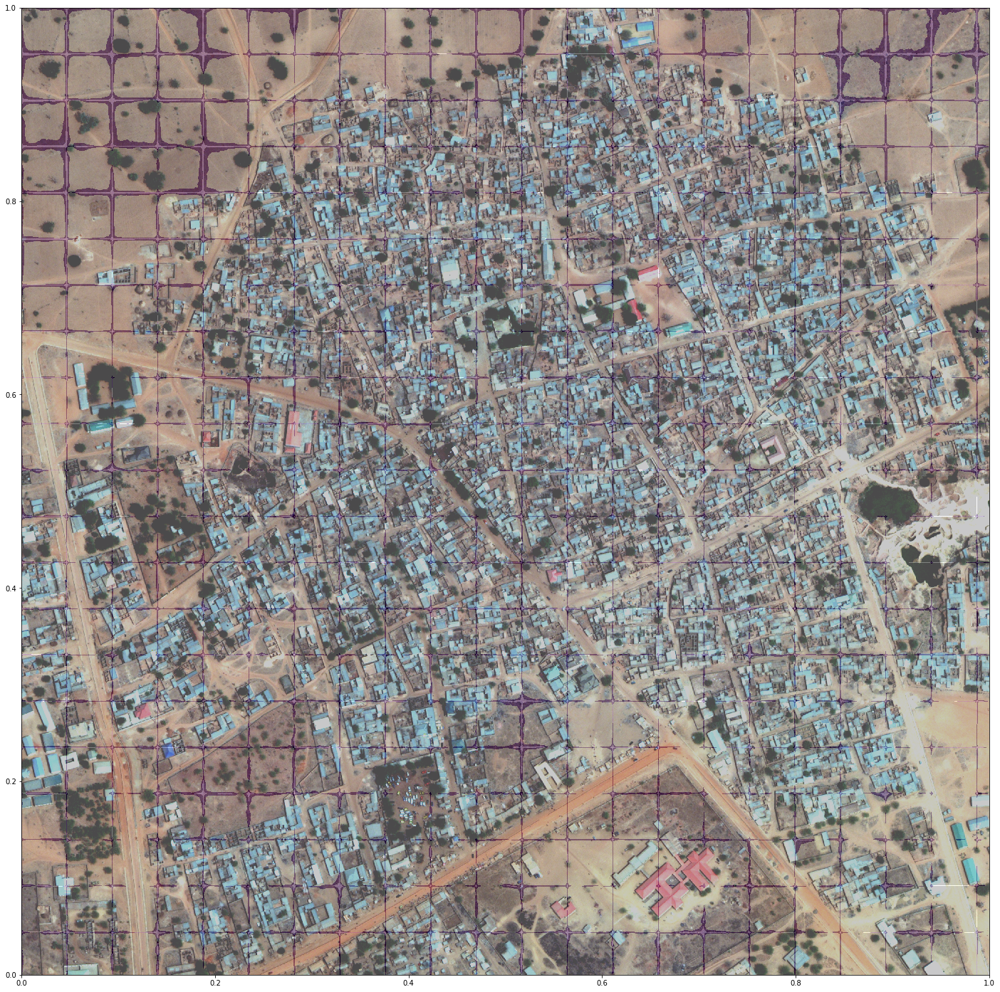

In [58]:
check_predict(model_RGB) #78.82% Jacard Score

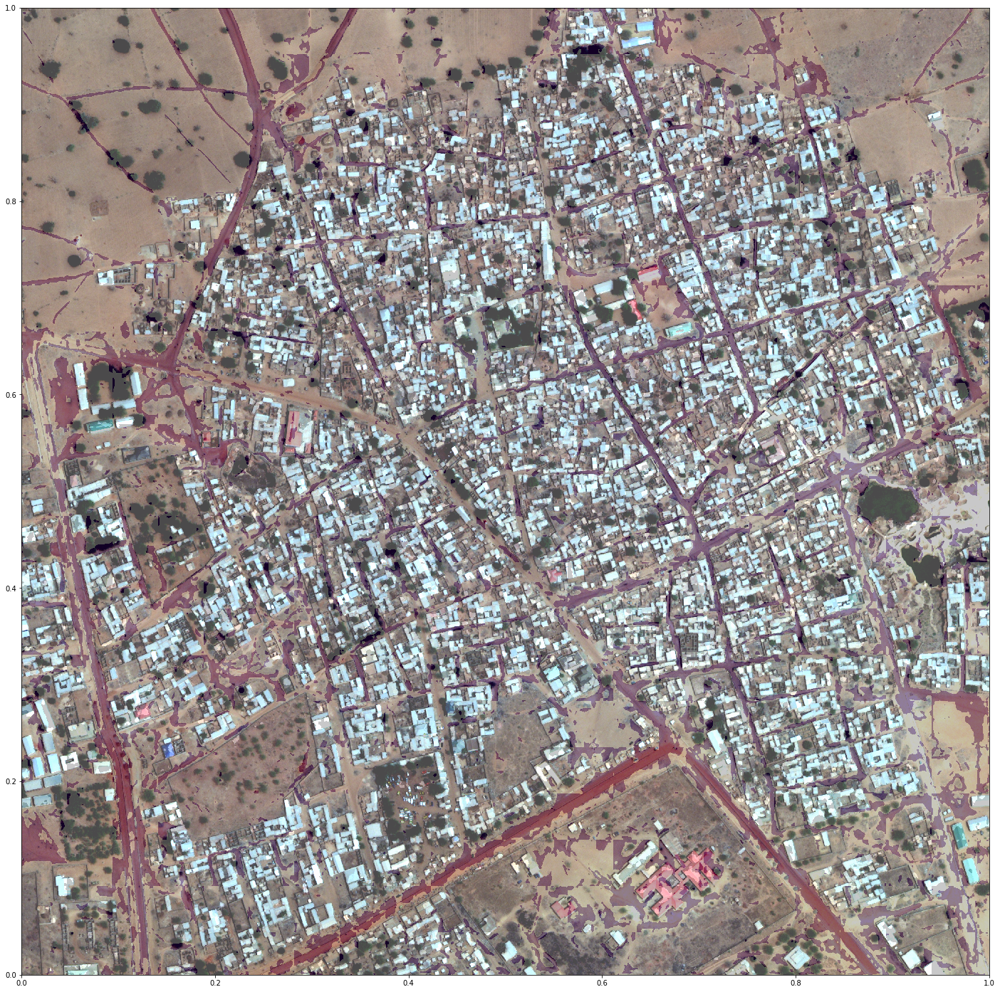

In [60]:
check_predict(model_RGB2) # 94.96% Jacard Score, 10 repetitions, 64 batch size, 30 epochs